In [12]:
from ultralytics import YOLO
import os
import random
import cv2
import numpy as np
import shutil
import supervision as sv
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import time
import pandas as pd
from IPython.display import display

In [2]:
keypoints = {1: (44, 30), 2: (457, 30), 3: (44, 563), 4: (457, 563), 5: (44, 138), 6: (174, 138), 7: (174, 230), 8: (174, 346), 9: (174, 453), 10: (44, 453), 11: (44, 230), 12: (86, 230), 13: (86, 368), 14: (44, 368), 15: (130, 295), 16: (457, 230), 17: (457, 295), 18: (457, 368), 19: (201, 295), 20: (387, 295), 21: (530, 295), 22: (870, 30), 23: (870, 563), 24: (870, 138), 25: (740, 138), 26: (740, 230), 27: (740, 346), 28: (740, 453), 29: (870, 453), 30: (870, 230), 31: (827, 230), 32: (827, 368), 33: (870, 368), 34: (785, 295), 35: (712, 295)}

In [3]:
# Choose dataset 1 or 2:
dataset = 2  # 1 or 2

if dataset == 1:
    data_folder = "1_train-val_1min_aalesund_from_start"
    yaml_file = "yaml_files/keypoint_1.yaml"
    labels = "labels_1"

else:
    data_folder = "2_train-val_1min_after_goal"
    yaml_file = "yaml_files/keypoint_2.yaml"
    labels = "labels_2"

In [9]:
# Find the latest model with the best performance
def find_latest_model_with_best(base_path, data_folder, type='keypoints'):
    detect_path = os.path.join(base_path, 'runs', type, data_folder)
    training_sessions = [os.path.join(detect_path, d) for d in os.listdir(detect_path) if os.path.isdir(os.path.join(detect_path, d))]
    
    best_model_paths = []

    for session in training_sessions:
        best_model_path = os.path.join(session, 'weights', 'best.pt')
        if os.path.exists(best_model_path):
            best_model_paths.append((best_model_path, os.path.getmtime(best_model_path)))

    if not best_model_paths:
        print("Ingen 'best.pt' fil funnet i noen av treningsøktene.")
        return None
    
    best_model_paths.sort(key=lambda x: x[1], reverse=True)
    print(f"Bruker modell fra {best_model_paths[0][0]}")
    return best_model_paths[0][0]


base_path = '/work/mbergst/TDT4265_Project' 

In [10]:
model = YOLO(find_latest_model_with_best(base_path, data_folder))

Bruker modell fra /work/mbergst/TDT4265_Project/runs/keypoints/1_train-val_1min_aalesund_from_start/changed-shear-perspective3/weights/best.pt


In [4]:
# Tracking

all_frames = f'/datasets/tdt4265/other/rbk/{data_folder}/img1'
frame_paths = sorted([os.path.join(all_frames, f) for f in os.listdir(all_frames) if f.endswith('.jpg')])


In [5]:

%matplotlib inline

def within_image_bounds(image, x, y):
    return 0 <= x < image.width and 0 <= y < image.height


def plot_pred_on_image(ax, image_path, keypoints, keypoint_labels, players, ball, point_radius=5, label_offset=(10, -10)):


    image = Image.open(image_path)
    ax.imshow(image)

    # Add check if the plot is outside image dimensions

    for (x, y), label in zip(keypoints, keypoint_labels):
        if within_image_bounds(image, x, y):
            ax.scatter(x, y, color='blue', s=point_radius**2)
            ax.text(x + label_offset[0], y + label_offset[1], label, color='blue', fontsize=9)
        else:
            print(f"Point {label} is outside image dimensions: {x}, {y}")
    
    # Flip the x-coordinates of the players and the ball if dataset 1 is used, different plotting on dataset 1 and 2
    if dataset == 1:
        players = [(image.width - x, y) for x, y in players]
        ball = (image.width - ball[0], ball[1])

    for player in players:
        if within_image_bounds(image, player[0], player[1]):
            ax.scatter(player[0], player[1], color='purple', s=point_radius**2)
        else:
            print(f"Player is outside image dimensions: {player[0]}, {player[1]}")

    if within_image_bounds(image, ball[0], ball[1]):
        ax.scatter(ball[0], ball[1], color='orange', s=point_radius**2)
    else:
        print(f"Ball is outside image dimensions: {ball[0]}, {ball[1]}")
    
    ax.axis('off')


Known coordinates of each keypoint on pitch:


,1,2,3,4,5,6,7,8,9,10,...,26,27,28,29,30,31,32,33,34,35
x,44,457,44,457,44,174,174,174,174,44,...,740,740,740,870,870,827,827,870,785,712
y,30,30,563,563,138,138,230,346,453,453,...,230,346,453,453,230,230,368,368,295,295



image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000001.jpg: 736x1280 1 kp2, 1 kp16, 1 kp17, 1 kp18, 1 kp20, 1 kp21, 3.1ms
Speed: 5.7ms preprocess, 3.1ms inference, 0.7ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000001.jpg: 1088x1920 22 players, 4.2ms
Speed: 5.9ms preprocess, 4.2ms inference, 0.9ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000001.jpg: 1088x1920 1 ball, 3.1ms
Speed: 3.1ms preprocess, 3.1ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)


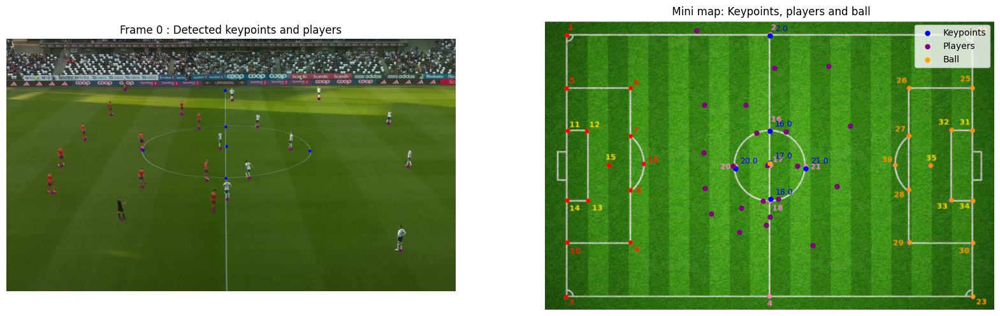


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000101.jpg: 736x1280 1 kp2, 1 kp16, 1 kp17, 1 kp18, 1 kp20, 1 kp21, 2.8ms
Speed: 2.6ms preprocess, 2.8ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000101.jpg: 1088x1920 22 players, 2.7ms
Speed: 4.9ms preprocess, 2.7ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000101.jpg: 1088x1920 1 ball, 6.7ms
Speed: 5.2ms preprocess, 6.7ms inference, 11.4ms postprocess per image at shape (1, 3, 1088, 1920)


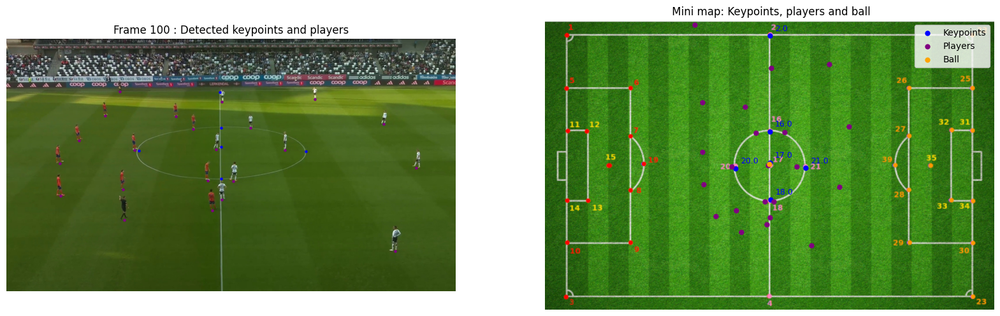


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000201.jpg: 736x1280 1 kp2, 1 kp16, 1 kp17, 1 kp18, 1 kp20, 1 kp21, 4.4ms
Speed: 4.0ms preprocess, 4.4ms inference, 0.9ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000201.jpg: 1088x1920 22 players, 4.3ms
Speed: 5.5ms preprocess, 4.3ms inference, 0.9ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000201.jpg: 1088x1920 (no detections), 4.0ms
Speed: 5.7ms preprocess, 4.0ms inference, 0.4ms postprocess per image at shape (1, 3, 1088, 1920)


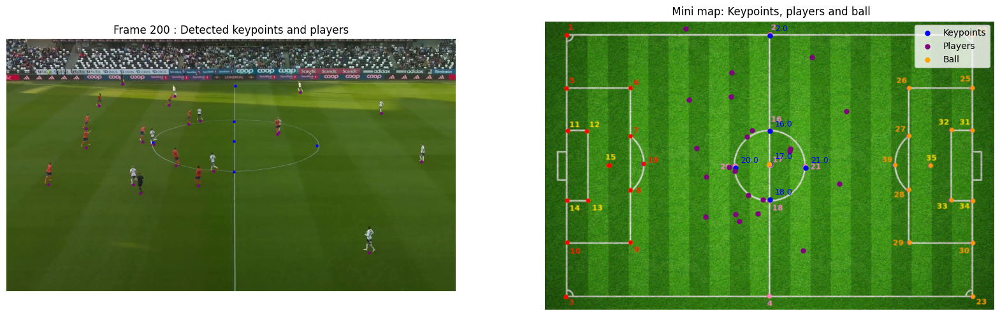


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000301.jpg: 736x1280 1 kp2, 1 kp16, 1 kp17, 1 kp18, 1 kp20, 1 kp21, 2.5ms
Speed: 2.7ms preprocess, 2.5ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000301.jpg: 1088x1920 22 players, 2.7ms
Speed: 4.2ms preprocess, 2.7ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000301.jpg: 1088x1920 1 ball, 2.7ms
Speed: 4.9ms preprocess, 2.7ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)


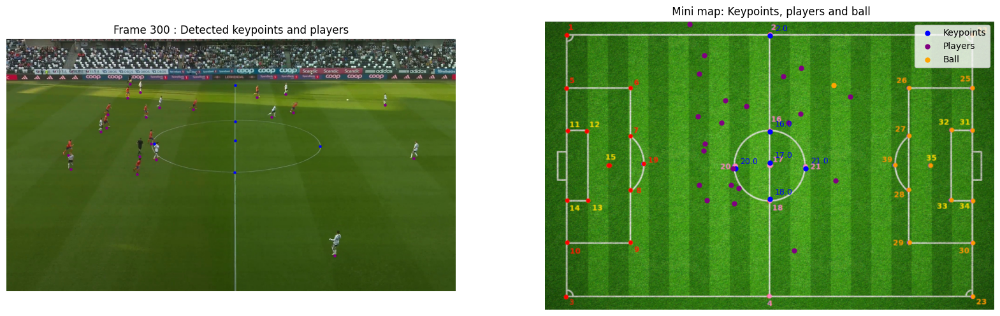


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000401.jpg: 736x1280 1 kp1, 1 kp2, 1 kp7, 1 kp16, 1 kp17, 1 kp18, 1 kp20, 1 kp21, 2.6ms
Speed: 2.6ms preprocess, 2.6ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000401.jpg: 1088x1920 22 players, 2.6ms
Speed: 4.0ms preprocess, 2.6ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000401.jpg: 1088x1920 1 ball, 2.8ms
Speed: 4.7ms preprocess, 2.8ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)


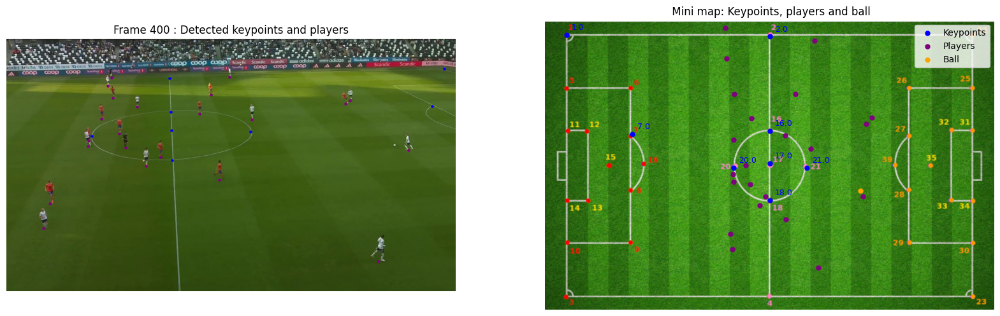


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000501.jpg: 736x1280 1 kp2, 1 kp16, 1 kp17, 1 kp18, 1 kp20, 1 kp21, 2.7ms
Speed: 2.7ms preprocess, 2.7ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000501.jpg: 1088x1920 22 players, 3.2ms
Speed: 3.6ms preprocess, 3.2ms inference, 0.7ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000501.jpg: 1088x1920 1 ball, 2.7ms
Speed: 2.5ms preprocess, 2.7ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)


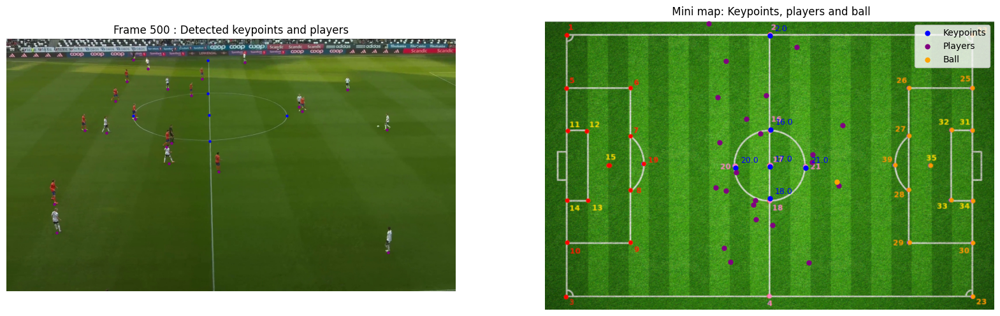


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000601.jpg: 736x1280 1 kp2, 1 kp6, 1 kp16, 1 kp17, 1 kp18, 1 kp20, 1 kp21, 2.7ms
Speed: 2.8ms preprocess, 2.7ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000601.jpg: 1088x1920 22 players, 2.6ms
Speed: 2.5ms preprocess, 2.6ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000601.jpg: 1088x1920 1 ball, 2.7ms
Speed: 2.8ms preprocess, 2.7ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)
Player is outside image dimensions: -1090.6198067466294, -1404.0713288564275
Player is outside image dimensions: -506.3006671499288, 143.25133166663286
Player is outside image dimensions: 1024.8768545183175, 728.2898392863497


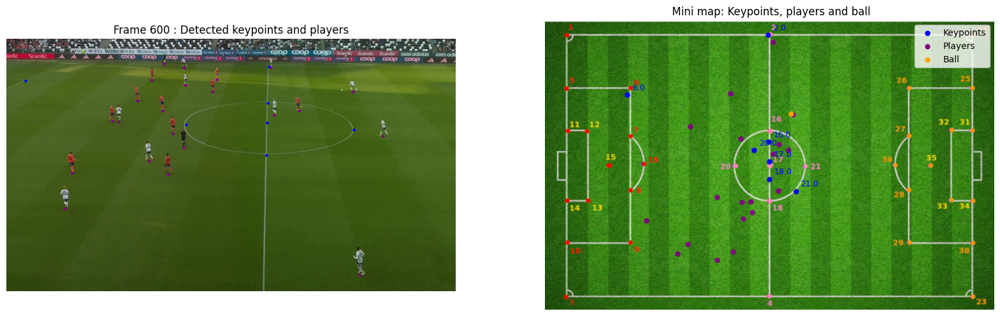


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000701.jpg: 736x1280 1 kp1, 1 kp2, 1 kp5, 1 kp6, 1 kp7, 1 kp16, 1 kp17, 1 kp18, 1 kp19, 1 kp20, 1 kp21, 2.5ms
Speed: 2.5ms preprocess, 2.5ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000701.jpg: 1088x1920 23 players, 2.6ms
Speed: 2.5ms preprocess, 2.6ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000701.jpg: 1088x1920 1 ball, 2.4ms
Speed: 2.3ms preprocess, 2.4ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)


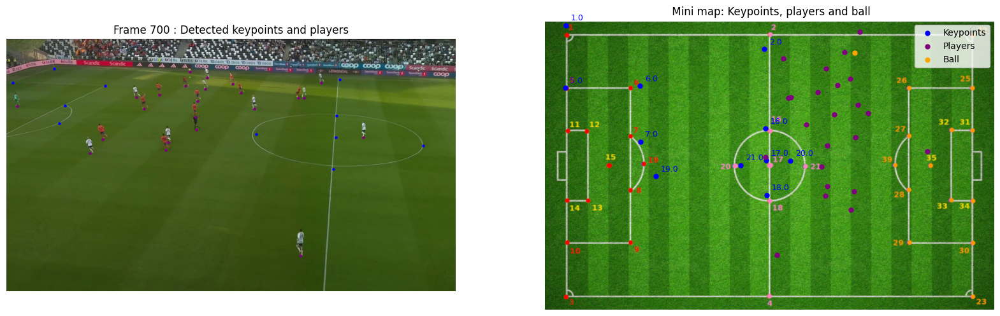


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000801.jpg: 736x1280 1 kp1, 1 kp2, 1 kp5, 1 kp6, 1 kp7, 1 kp8, 1 kp9, 1 kp11, 1 kp12, 1 kp15, 1 kp16, 1 kp17, 1 kp18, 1 kp19, 1 kp21, 3.0ms
Speed: 2.9ms preprocess, 3.0ms inference, 0.8ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000801.jpg: 1088x1920 23 players, 4.0ms
Speed: 5.8ms preprocess, 4.0ms inference, 1.1ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000801.jpg: 1088x1920 1 ball, 2.7ms
Speed: 2.6ms preprocess, 2.7ms inference, 0.7ms postprocess per image at shape (1, 3, 1088, 1920)


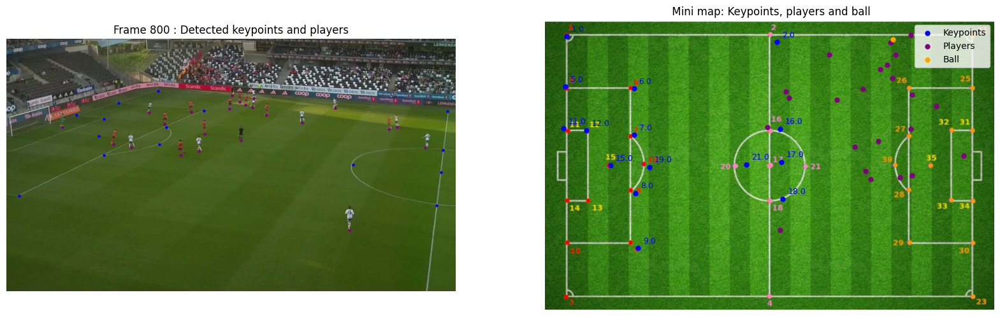


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000901.jpg: 736x1280 1 kp1, 1 kp5, 1 kp6, 1 kp7, 1 kp8, 1 kp9, 1 kp11, 1 kp12, 1 kp13, 1 kp15, 1 kp16, 1 kp17, 1 kp18, 1 kp19, 1 kp21, 2.6ms
Speed: 2.5ms preprocess, 2.6ms inference, 0.7ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000901.jpg: 1088x1920 23 players, 2.5ms
Speed: 4.5ms preprocess, 2.5ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/000901.jpg: 1088x1920 1 ball, 2.5ms
Speed: 4.5ms preprocess, 2.5ms inference, 0.5ms postprocess per image at shape (1, 3, 1088, 1920)


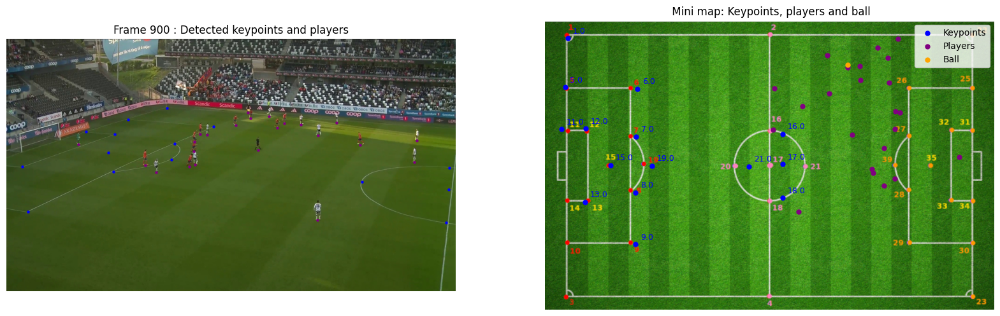


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001001.jpg: 736x1280 1 kp1, 1 kp2, 1 kp5, 1 kp6, 1 kp7, 1 kp8, 1 kp11, 1 kp12, 1 kp15, 1 kp16, 1 kp17, 1 kp18, 1 kp19, 1 kp21, 2.7ms
Speed: 2.7ms preprocess, 2.7ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001001.jpg: 1088x1920 23 players, 2.6ms
Speed: 3.5ms preprocess, 2.6ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001001.jpg: 1088x1920 1 ball, 2.6ms
Speed: 2.4ms preprocess, 2.6ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)


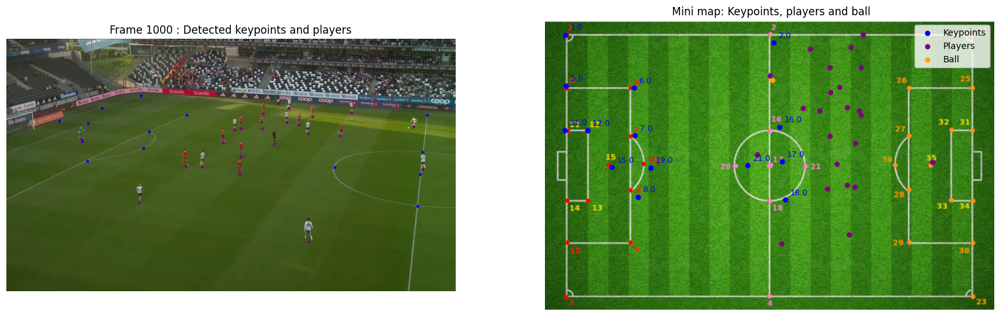


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001101.jpg: 736x1280 1 kp1, 1 kp2, 1 kp5, 1 kp6, 1 kp7, 1 kp8, 1 kp11, 1 kp12, 1 kp15, 1 kp16, 1 kp17, 1 kp18, 1 kp19, 1 kp21, 2.8ms
Speed: 2.9ms preprocess, 2.8ms inference, 0.8ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001101.jpg: 1088x1920 23 players, 2.9ms
Speed: 3.9ms preprocess, 2.9ms inference, 0.7ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001101.jpg: 1088x1920 1 ball, 2.7ms
Speed: 4.5ms preprocess, 2.7ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)


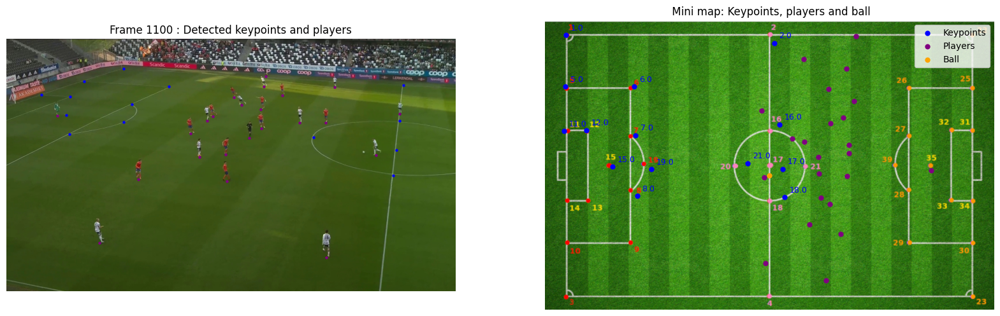


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001201.jpg: 736x1280 1 kp1, 1 kp5, 1 kp6, 1 kp7, 1 kp8, 1 kp9, 1 kp11, 1 kp12, 1 kp13, 1 kp15, 1 kp19, 1 kp21, 2.7ms
Speed: 2.8ms preprocess, 2.7ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001201.jpg: 1088x1920 23 players, 2.6ms
Speed: 3.4ms preprocess, 2.6ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001201.jpg: 1088x1920 (no detections), 2.5ms
Speed: 4.1ms preprocess, 2.5ms inference, 0.3ms postprocess per image at shape (1, 3, 1088, 1920)


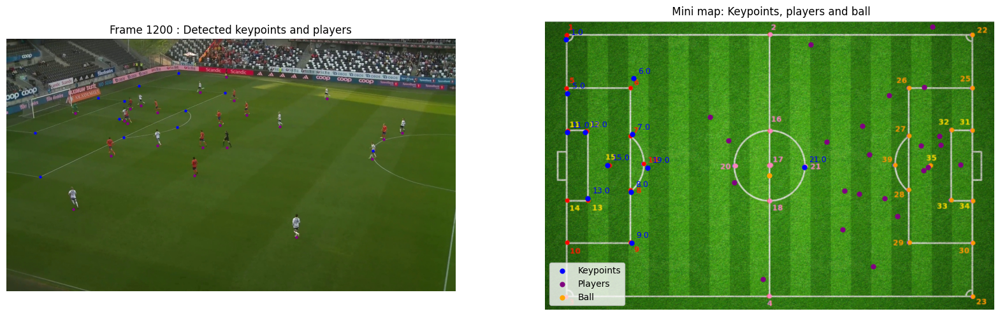


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001301.jpg: 736x1280 1 kp1, 1 kp5, 1 kp6, 1 kp7, 1 kp8, 1 kp9, 1 kp11, 1 kp12, 1 kp13, 1 kp14, 1 kp15, 1 kp21, 2.8ms
Speed: 3.2ms preprocess, 2.8ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001301.jpg: 1088x1920 23 players, 2.9ms
Speed: 4.5ms preprocess, 2.9ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001301.jpg: 1088x1920 1 ball, 2.6ms
Speed: 4.4ms preprocess, 2.6ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)


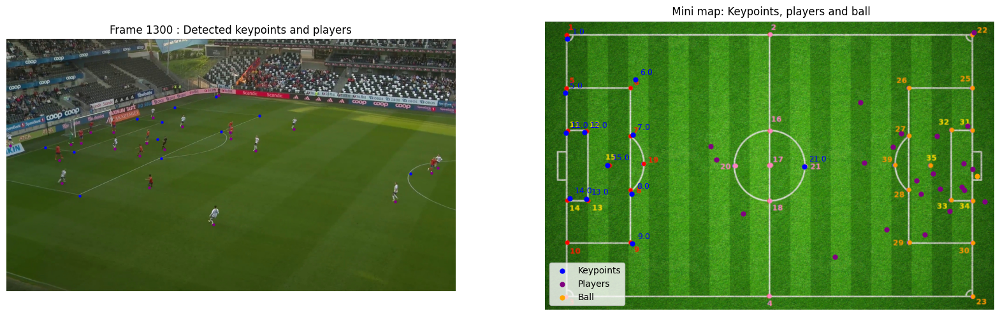


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001401.jpg: 736x1280 1 kp1, 1 kp2, 1 kp5, 1 kp6, 1 kp7, 1 kp8, 1 kp9, 1 kp11, 1 kp12, 1 kp13, 1 kp15, 1 kp16, 1 kp17, 1 kp18, 1 kp19, 1 kp21, 2.8ms
Speed: 2.7ms preprocess, 2.8ms inference, 0.7ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001401.jpg: 1088x1920 22 players, 2.9ms
Speed: 3.4ms preprocess, 2.9ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001401.jpg: 1088x1920 (no detections), 2.6ms
Speed: 3.1ms preprocess, 2.6ms inference, 0.3ms postprocess per image at shape (1, 3, 1088, 1920)


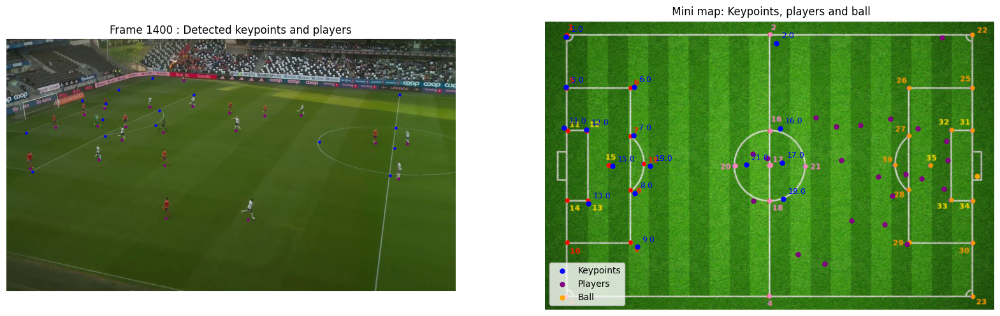


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001501.jpg: 736x1280 1 kp1, 1 kp2, 1 kp5, 1 kp6, 1 kp7, 1 kp8, 1 kp11, 1 kp12, 1 kp15, 1 kp16, 1 kp17, 1 kp18, 1 kp19, 2 kp21s, 2.8ms
Speed: 2.7ms preprocess, 2.8ms inference, 0.7ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001501.jpg: 1088x1920 23 players, 3.1ms
Speed: 4.1ms preprocess, 3.1ms inference, 0.7ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001501.jpg: 1088x1920 (no detections), 2.9ms
Speed: 4.0ms preprocess, 2.9ms inference, 0.3ms postprocess per image at shape (1, 3, 1088, 1920)


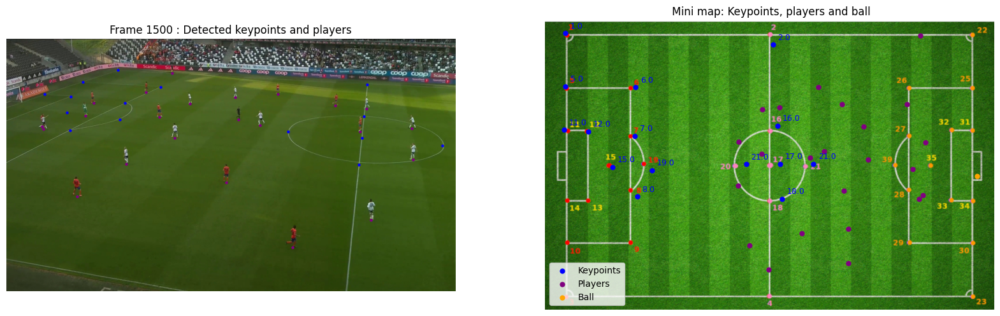


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001601.jpg: 736x1280 1 kp1, 1 kp2, 1 kp5, 1 kp6, 1 kp7, 1 kp8, 1 kp12, 1 kp15, 1 kp16, 1 kp17, 1 kp18, 2 kp21s, 2.5ms
Speed: 2.4ms preprocess, 2.5ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001601.jpg: 1088x1920 23 players, 2.6ms
Speed: 3.3ms preprocess, 2.6ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001601.jpg: 1088x1920 1 ball, 2.5ms
Speed: 2.6ms preprocess, 2.5ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)


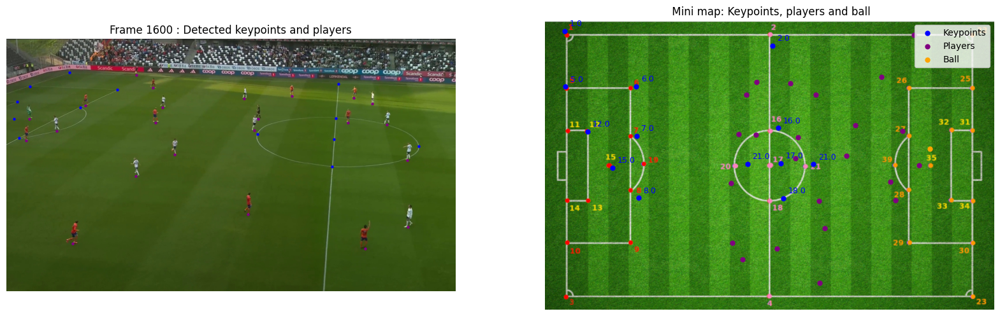


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001701.jpg: 736x1280 1 kp1, 1 kp2, 1 kp6, 1 kp7, 1 kp16, 1 kp17, 1 kp18, 1 kp19, 2 kp21s, 3.0ms
Speed: 3.3ms preprocess, 3.0ms inference, 0.7ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001701.jpg: 1088x1920 22 players, 3.8ms
Speed: 4.3ms preprocess, 3.8ms inference, 0.8ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001701.jpg: 1088x1920 (no detections), 3.9ms
Speed: 4.2ms preprocess, 3.9ms inference, 0.4ms postprocess per image at shape (1, 3, 1088, 1920)


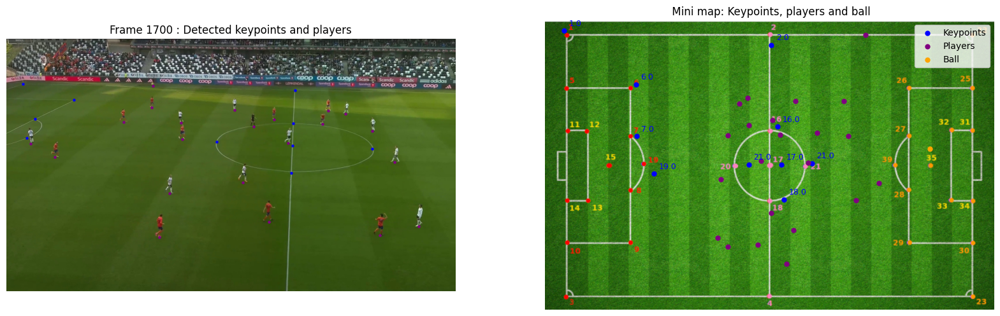


image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001801.jpg: 736x1280 1 kp2, 1 kp6, 1 kp7, 1 kp16, 1 kp17, 1 kp18, 2 kp21s, 2.9ms
Speed: 2.6ms preprocess, 2.9ms inference, 0.6ms postprocess per image at shape (1, 3, 736, 1280)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001801.jpg: 1088x1920 22 players, 3.0ms
Speed: 3.3ms preprocess, 3.0ms inference, 0.6ms postprocess per image at shape (1, 3, 1088, 1920)

image 1/1 /datasets/tdt4265/other/rbk/1_train-val_1min_aalesund_from_start/img1/001801.jpg: 1088x1920 (no detections), 2.6ms
Speed: 3.4ms preprocess, 2.6ms inference, 0.3ms postprocess per image at shape (1, 3, 1088, 1920)


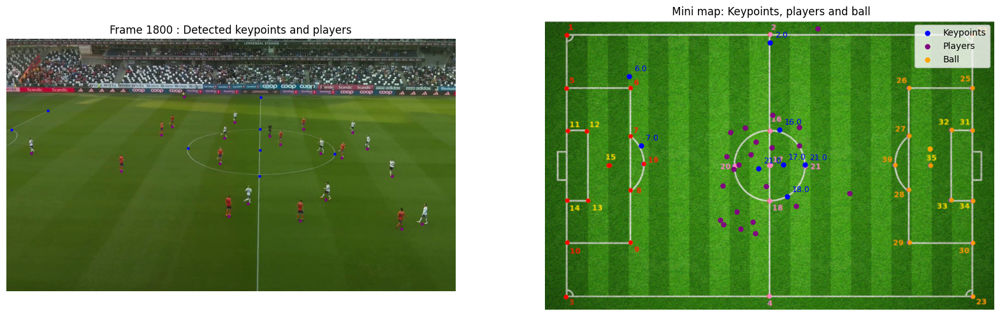

In [13]:
# Keypoint mapping


model_players = YOLO('/work/mbergst/TDT4265_Project/runs/detect/player/train7/weights/best.pt')
model_ball = YOLO('/work/mbergst/TDT4265_Project/runs/detect/ball/train12/weights/best.pt')

print("Known coordinates of each keypoint on pitch:")
display(pd.DataFrame(keypoints, index = ['x', 'y']))

# Initialize frame numbers
frame_number = 0

keypoints_displ_mean_tol = 10

keypoints_model_confidence_treshold = 0.5

mini_map_path = 'pitch.png'

# Iterate over frames
for i, frame in enumerate(frame_paths):
    frame_number = i 
    if frame_number % 100 == 0:
        for result_keyp, result_player, result_ball in zip(model.track(frame), model_players.track(frame), model_ball.track(frame)):
            
            # bounding boxes and labels for keypoints, players and ball
            bboxes_keyp = result_keyp.boxes.xyxy.cpu().numpy()
            bboxes_keyp_c = result_keyp.boxes.xywh.cpu().numpy()
            labels_keyp = list(result_keyp.boxes.cls.cpu().numpy())


            bboxes_player = result_player.boxes.xyxy.cpu().numpy()
            bboxes_player_c = result_player.boxes.xywh.cpu().numpy()
            labels_player = list(result_player.boxes.cls.cpu().numpy())
            

            bboxes_ball = result_ball.boxes.xyxy.cpu().numpy()
            bboxes_ball_c = result_ball.boxes.xywh.cpu().numpy()
            labels_ball = list(result_ball.boxes.cls.cpu().numpy())

            # Detected labels source points
            detected_labels_src = np.array([list(np.round(bboxes_keyp_c[i][:2]).astype(int)) for i in range(bboxes_keyp_c.shape[0])])
            image = Image.open(frame)


            # Detected labels destination points
            detected_labels_dst = np.array([keypoints[i +1] for i in labels_keyp])

            bboxes_player_c_0 = bboxes_player_c[[i==0 for i in labels_player]]

            # Get coordinates of detected players as x_center, y_center + h/2
            detected_player_src = bboxes_player_c[:, :2] + np.array([[0]*bboxes_player_c_0.shape[0], bboxes_player_c_0[:, 3] / 2]).T
            # plot player points on frame



            # Get coordinates of detected ball as x_center, y_center
            detected_ball_src = bboxes_ball_c[0, :2] if len(bboxes_ball_c) > 0 else []

            #print("detected labels src", detected_labels_src)
            #print("detected labels dst", detected_labels_dst)
            # Calculate homography transformation matrix if more than 3 keypoints are detected
            if len(detected_labels_src) > 3:
                H, _ = cv2.findHomography(detected_labels_src, detected_labels_dst)
                #print("H", H)

                # Transform keypoint coordinates from fram to pitch.png using calculated homography matrix
                # pred_dst_pts = cv2.perspectiveTransform(np.array([bboxes_keyp_c[:, :2]]), H).squeeze()

                pred_dest_keypoints = []
                for pt in detected_labels_src:
                    pt = np.append(np.array(pt), np.array([1]), axis=0) 
                    dest_point = np.matmul(H, np.transpose(pt))
                    dest_point = dest_point / dest_point[2]
                    pred_dest_keypoints.append(list(np.transpose(dest_point)[:2]))
                pred_dest_keypoints = np.array(pred_dest_keypoints)

                #print("pred_dest_keypoints", pred_dest_keypoints)

                pred_player_points = []
                for pt in detected_player_src:
                    pt = np.append(np.array(pt), np.array([1]), axis=0) 
                    dest_point = np.matmul(H, np.transpose(pt))
                    dest_point = dest_point / dest_point[2]
                    pred_player_points.append(list(np.transpose(dest_point)[:2]))
                pred_player_points = np.array(pred_player_points)

                #print("pred_player_points", pred_player_points)

                if len(detected_ball_src) > 0:
                    pt = np.append(np.array(detected_ball_src), np.array([1]), axis=0) 
                    dest_point = np.matmul(H, np.transpose(pt))
                    dest_point = dest_point / dest_point[2]
                    detected_ball_dst = np.transpose(dest_point)
            
                #print("detected_ball_dst", detected_ball_dst)

                # Add +1 for every label to match the pitch picture when plotting
                labels_keyp = [label + 1 for label in labels_keyp]

                plt.ion()
                fig, axes = plt.subplots(1, 2, figsize=(20, 16))

                axes[0].imshow(image)
                for keypoint in detected_labels_src:
                    axes[0].scatter(keypoint[0], keypoint[1], color='blue', s=5)
                for player in detected_player_src:
                    axes[0].scatter(player[0], player[1], color='purple', s=5)
                # Dont plot ball since the dot covers it on the frame, can see it on the minimap
                # if len(detected_ball_src) > 0:
                #     axes[0].scatter(detected_ball_src[0], detected_ball_src[1], color='orange', s=5)
                
                axes[0].axis('off')
                axes[0].title.set_text(f"Frame {frame_number} : Detected keypoints and players")

                # Draw keypoints, players and ball on pitch
                plot_pred_on_image(axes[1], mini_map_path, pred_dest_keypoints, labels_keyp, pred_player_points, detected_ball_dst)
                plt.legend(['Keypoints', 'Players', 'Ball'])
                leg = axes[1].get_legend()
                leg.legend_handles[0].set_color('blue')
                leg.legend_handles[1].set_color('purple')
                leg.legend_handles[2].set_color('orange')
                
                axes[1].title.set_text(" Mini map: Keypoints, players and ball")
                
                plt.show()
                
            else:
                print("Not enough keypoints detected for homography calculation in frame", frame_number)
                continue


        

